Clusters and Layers
====================
This notebook shows how to use **clusters** to plot multiple
sites found at the same geographic location using `folium` maps
through `GeoDataFrame.explore()`. It also demonstrates how to use
**layers** to enable user-controlled map layers which can be toggled
on/off. Finally, it injects custom JavaScript to control
zoom level (or, potentially, other features), and how to export
maps as HTML with custom JS as well as headers and legends.

Technical features highlighted here;

- drawing borders around specific shapes in a plot
- multiple layers of Folium maps
- custom zooming and centering of Folium maps
- clustering points with more than one entity at a single location
- saving maps as HTML
- adding custom HTML header and footers to exported maps

Import modules and gather/merge the data
----------------------------------------

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import folium
from folium.map import Element
import seaborn as sns
from IPython.display import Markdown as md
from IPython.display import display, HTML

from nycschools import schools, geo, ui

# load all of the data and clean it up
loc = geo.load_school_locations()
districts = geo.load_districts()
df = schools.load_school_demographics()

# just get the most recent year for school demographics
df = df[df.ay == df.ay.max()]

# merge school locations and demographics
# get only the demo columns that aren't in locations already
cols = ["dbn"] + list(set(df.columns) - set(loc.columns))

# data is the GeoDataFrame we will use to make our maps
data = loc.merge(df[cols], on="dbn", how="inner")


In [5]:
# create an interactive map of the schools over a map of NYC

# create a map centered at PS 46 in Brooklyn
center = (data[data.dbn == "13K046"].latitude, data[data.dbn == "13K046"].longitude)
m = folium.Map(location=center, zoom_start=11)
# Add district layer (unchanged)
folium.GeoJson(districts, name='District').add_to(m)


# map the 32 geo school districts and label them
district_map = districts.explore( m=m, 
               popup=False, 
               tooltip=False, 
               legend=False, 
               column="district", 
               tiles="CartoDB positron", 
               cmap="tab20b", 
               style_kwds={"color": "black"})




# make the popup info column
# '----' is a separator for the popup
info = ["dbn", "school_name", "principal_name", "open_date",
        "----",
        "total_enrollment", "poverty_pct", "ell_pct", "swd_pct", 
        "----",
        "asian_pct", "black_pct", "hispanic_pct", "white_pct"
       ]

# create a new column for the popup info
data["school info"] = data.apply(ui.popup(info), axis=1)

# get geojson for the different layers
charters = data[data.district == 84]
community = data[data.district < 33]



# Add circle markers for charters and community
all = ui.create_layer(m, data, "All Schools", tooltip="school info").add_to(m)
# charters = ui.create_layer(m, charters, "Charter Schools").add_to(m)
# community = ui.create_layer(m, community, "Community Schools", tooltip="school info", ).add_to(m)

# Layer control
folium.LayerControl().add_to(m)

# js = f"""
# <script>
# map.removeLayer(map._layers[{charters._id});
# </script>
# """

# m.get_root().header.add_child(folium.Element(js))

# add a label to each district with the district number
_ = ui.label_shapes(m, districts, "district", style={ "color": "black", "font-size": "16px"})

m

In [3]:


school_map = all_schools.explore(m=district_map, tooltip=False, popup="school info", color="color", legend=False, marker_kwds=marker, style_kwds=style)


marker["radius"] = 10
# map the spencer schools
spencer_map = data[data.dbn.isin(spencer_schools.dbn)].explore(m=school_map, tooltip=False, popup="school info", color="color", legend=False, marker_kwds=marker, style_kwds=style)


NameError: name 'all_schools' is not defined

In [ ]:


# create a legend and save the map

header = """
<body>
<div style="margin: 1em;">
    <h1>Map of NYC Schools</h1>
    <table style="margin: 1em">
        <tr>
            <td><span style="color: red">●</span> Spencer school</td>
            <td><span style="padding-left: .5em; color: blue">●</span> community school</td>
        </tr>
        <tr>
            <td><span style="color: green">●</span> charter school</td>
            <td><span style="padding-left: .5em; color: purple">●</span> SPED school (d. 75)</td>
        </tr>
        <tr>
            <td><span style="color: black">●</span> transfer school</td>
            <td></td>
        </tr>
    </table>
</div>
"""

file_path = "spencer-schools.html"
spencer_map.save(file_path)

# open the map html and insert the header at the top of page
with open(file_path, 'r') as file:
    content = file.read()


content = content.replace('<body>', header)

with open(file_path, 'w') as file:
    file.write(content)

spencer_map


In [ ]:
from folium import Marker
from folium.plugins import MarkerCluster

# Create a base map
cluster_map = districts.explore(tooltip=False, popup=False, legend=False, column="district", tiles="CartoDB positron", cmap="tab20b", style_kwds={"color": "black"})


def plot_clusters(group):
    # create a marker for each group
    cluster_point = MarkerCluster(options={'disableClusteringAtZoom': 14})
    cluster_point.add_to(cluster_map)

    def plot_cluster(row):
        icon = folium.Icon(color="red", icon="circle")
        Marker(location=[row.geometry.y, row.geometry.x], popup=row["school info"],
               color=row.color, marker_kwds=marker, style_kwds=style).add_to(cluster_point)

    if len(group) > 1:
        group.apply(plot_cluster, axis=1)



data["xy"] = data.apply(lambda row: f"{row.geometry.x}{row.geometry.y}", axis=1)
clusters = data.groupby("xy")
non_clustered = clusters.filter(lambda x: len(x) == 1)
non_clustered.explore(m=cluster_map, tooltip=False, popup="school info", color="color", legend=False, marker_kwds=marker, style_kwds=style)
clusters.apply(plot_clusters)
cluster_map


In [ ]:
m = folium.Map(location=[44, -73], zoom_start=5)

marker_cluster = MarkerCluster().add_to(m)

folium.Marker(
    location=[-73.70861787557624, 40.734266554767906],
    popup="Add popup text here.",
    icon=folium.Icon(color="green", icon="ok-sign"),
).add_to(marker_cluster)


folium.Marker(
    location=[-73.70861787557624, 40.734266554767906],
    popup="Add popup text here.",
    icon=folium.Icon(color="green", icon="ok-sign"),
).add_to(marker_cluster)


folium.Marker(
    location=[-73.72159447902418, 40.74955680534802],
    popup="Add popup text here.",
    icon=folium.Icon(color="green", icon="ok-sign"),
).add_to(marker_cluster)


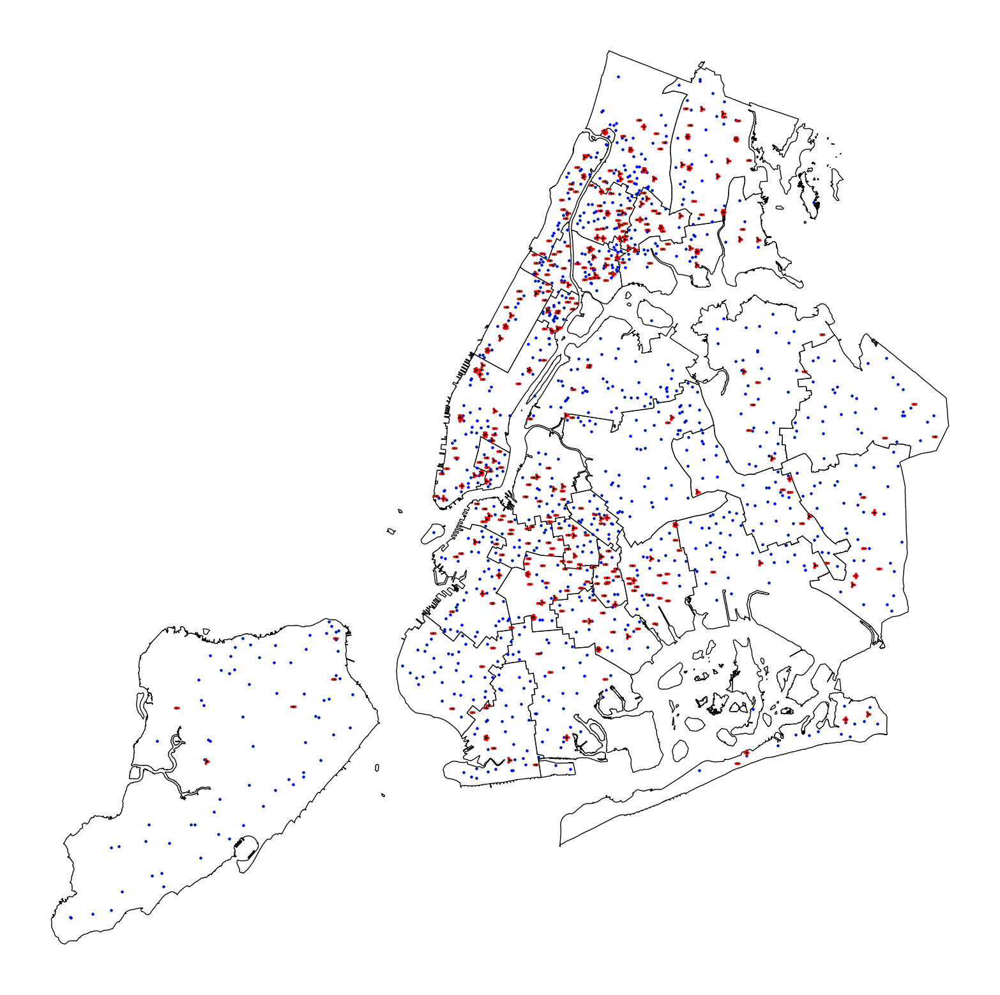

all schools 1312
clustered schools 1312
non-clustered schools 967


In [ ]:

import numpy as np
gdf = data.copy()

non_clustered = clusters.filter(lambda x: len(x) == 1)
cluster_centers = clusters['geometry'].apply(lambda x: x.iloc[0])



# Calculate radial positions

def radial_positions(center, num_points):
    angles = np.linspace(0, 2*np.pi, num_points + 1)[:-1]
    r = 0.001  # This can be adjusted based on desired spacing
    positions = [(center.x + r*np.cos(angle), center.y + r*np.sin(angle)) for angle in angles]
    return positions


fig, ax = plt.subplots(figsize=(16, 16))
sns.set_context('talk')
plt.axis('off')
fig.tight_layout()
districts.plot(ax=ax, color='white', edgecolor='black', linewidth=1)



# 1. Plot non-clustered points as blue circles

# 2. Plot cluster centers as green circles

cluster_centers.plot(ax=ax, color='green', markersize=3)
non_clustered.plot(ax=ax, color='blue', markersize=2)

for _, group in clusters:
    if len(group) > 1:
        center = group.iloc[0]['geometry']
        positions = radial_positions(center, len(group))
        ax.plot([center.x]*len(positions), [center.y]*len(positions))

        for pos, geom in zip(positions, group['geometry']):
            ax.plot([center.x, pos[0]], [center.y, pos[1]],'k-')  # Line between center and point
            ax.plot(pos[0], pos[1], 'ro', markersize=2)  # Radial points


plt.show()

print("all schools", len(gdf.geometry.unique()))
print("clustered schools", len(cluster_centers))
print("non-clustered schools", len(non_clustered.dbn.unique()))

